# PHYS6318: Lecture 2

In [1]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as plt
import numpy as np
import xarray as xr
import netCDF4
import time
import os
import glob

# OMB Chapter 3: Basics of Geophysical Fluid Dynamics

PHYS 6318 assumes that you have already taken a course on GFD (such as PHYS6310) so  I'll leave OMB 3.1-3.4 for you to review on your own.

## OMB 3.5 Visualization of a Wave Using Matplotlib



A waves travelling in the $x$-direction can be written generally as

$$ A(x, t) = A_0 \sin \left[ 2\pi \left( \frac{x}{\lambda} - \frac{t}{T} \right) \right] $$

where $A$ is a property experiencing oscillations such as sea level, $A_0$ is the constant
wave amplitude, being half the difference between maximum and minimum values
of $A$, $\lambda$ is wavelength, and $T$ is wave period.

The *phase speed* of a wave is given by the ratio between wavelength and wave
period:

$$ c = \frac{\lambda}{T} $$

With this phase speed, the wave expresion can be rewritten as:

$$ A(x, t) = A_0 \sin \left[ \frac{2\pi}{\lambda} \left( x - c t \right) \right] $$

A positive $c$ makes the wave propagating into the positive x-direction, whereas a
negative $c$ makes it running into the opposite direction.

With NumPy and Matplotlib, we can explore these waves as follows.

In [2]:
# wave parameters
T = 60
λ = 100
A0 = 1

xmax = 10*λ

# discrete grid points in x-direction
x = np.arange(0, xmax, xmax/500) 

We can define our wave function as a Python function:

In [4]:
def A(x, t):
    
    c = λ / T
    
    return A0 * np.sin( 2*np.pi / λ * (x - c * t))

Then we can plot our wave at any time $t$ as follows

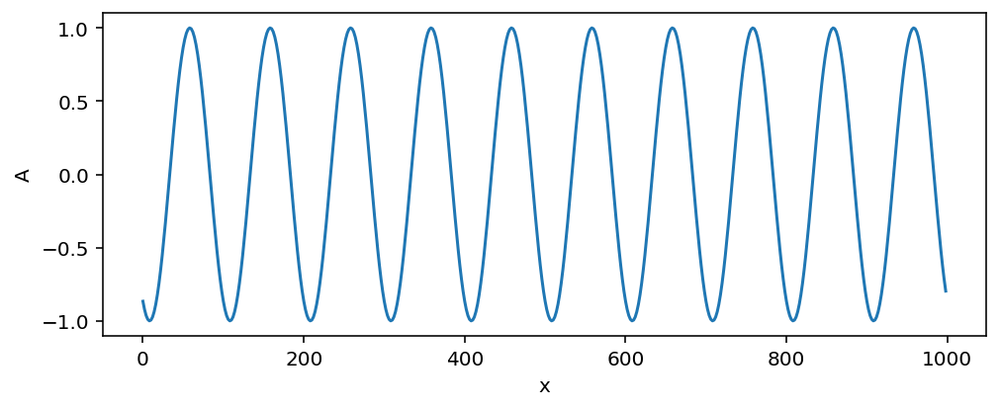

In [12]:
t = 20
fig, ax = plt.subplots(figsize=(8,3))
plt.plot(x, A(x, t))
plt.xlabel('x')
plt.ylabel('A')
plt.show()

To make animation of this wave as it propagates, we will use

In [15]:
from matplotlib.animation import FuncAnimation

Suppose we want to simulate this function for discrete steps in time.

In [16]:
tmax = 10*T # simulate ten periods of wave
dt = tmax/200 # time step
t = np.arange(0, tmax, dt)

The follow code sets up an animation loop. Any graphical element that needs to be updated between the frames of the animation needs to be "returned" from the functions `init()` and `update()`.

In [17]:
def make_animation():
    # create figure for animation
    fig, ax = plt.subplots(figsize=(3,2), # fig size in inches
                           dpi=150,       # dots-per-inch
                           constrained_layout=True)
    line, = ax.plot([], [], 'b-')

    def init():
        "plotting functions run only once"
        ax.set_xlim(0, xmax)
        ax.set_ylim(-2, 2)
        ax.set_xlabel('x')
        ax.set_ylabel('A')
        
        return line,

    def update(frame):
        "plotting functions run for each frame number"
        f = A(x, t[frame])
        line.set_data(x, f)

        return line,

    anim = FuncAnimation(fig, update, frames=len(t),
                         init_func=init, blit=True)

    plt.close()
    
    return anim

anim = make_animation()

To make the animation appear we have to render it to a file. Behind the scenes this precreating all of the necessary frames of the animation.

In [19]:
from IPython.display import HTML

HTML(anim.to_jshtml())

The reason we need to explicitly call `HTML()` is because Jupyter does not know how to represent the `anim` object.

In [20]:
anim._repr_html_() is None

True

We can make this a bit cleaner by setting this option:

In [21]:
from matplotlib import rcParams
rcParams['animation.html'] = 'jshtml'

(Going forward, we'll always set this option at the beginning our notebooks)

In [22]:
anim = make_animation()

In [23]:
anim

See [Louis Tiao's post](http://louistiao.me/posts/notebooks/embedding-matplotlib-animations-in-jupyter-as-interactive-javascript-widgets/) for more information about animating with Matplotlib inside a Jupyter notebook.

## Wave Interference

We can extend this to multiple graphical elements.  Consider the interface of two waves of the same amplitude $A_0 = 1$ m.  The resultant wave can be described by:

$$ A(x, t) = A_0 \left\{  \sin \left[ 2\pi \left( \frac{x}{\lambda_1} - \frac{t}{T_1} \right) \right]  +  \sin \left[ 2\pi \left( \frac{x}{\lambda_2} - \frac{t}{T_2} \right) \right] \right\} $$

In [30]:
def animate_two_waves(λ2=100, T2=50):
    
    # wave parameters of first wave
    T1 = 60
    λ1 = 100
    A0 = 1

    def A(x, t, λ, T):
        c = λ / T
        return A0 * np.sin( 2*np.pi / λ * (x - c * t))
    
    xmax = 10*λ1

    # discrete grid points in x-direction
    x = np.arange(0, xmax, xmax/500) 
    
    tmax = 10*T1 # simulate ten periods of wave
    dt = tmax/200 # time step
    t = np.arange(0, tmax, dt)
    
    fig, (ax1, ax2, ax3) = plt.subplots(nrows=3, 
                                        facecolor="white",
                                        figsize=(8, 6),
                                       )
    ax_common = fig.add_subplot(111, frame_on=False)
    
    line1, = ax1.plot([], [], 'b-')
    line2, = ax2.plot([], [], 'r-')
    line3, = ax3.plot([], [], 'm-')
    title3 = ax3.set_title([])

    def init():

        ax_common.tick_params(labelcolor="none", bottom=False, left=False)
        ax_common.set_xlabel("x (m)")
        ax_common.set_ylabel("Surface Elevation (m)")
        
        for ax in [ax1, ax2, ax3]:
            ax.set_xlim(0, xmax)
            ax.set_ylim(-2, 2)
            
        ax1.set_xticks([])
        ax2.set_xticks([])
        ax1.set_title(f'Wave 1, λ={λ1} m, T={T1} s')
        ax2.set_title(f'Wave 2, λ={λ2} m, T={T2} s')
            
        return line1, line2, line3, title3

    def update(frame):
        f1 = A(x, t[frame], λ1, T1)
        f2 = A(x, t[frame], λ2, T2)
        f3 = f1 + f2

        line1.set_data(x, f1)
        line2.set_data(x, f2)
        line3.set_data(x, f3)
        title3.set_text(f'Wave 1+2, t={t[frame]:.1f} s')
        
        return line1, line2, line3, title3

    anim = FuncAnimation(fig, update, 
                         frames=len(t),
                         #frames=2, # trick to limit number of frames
                         init_func=init, blit=True)

    plt.close()
    
    return anim

In [31]:
anim = animate_two_waves()
anim

When creating animations it can helpful to only produce a few frames when adjusting the layout by changing the line

`frames=len(t),`

to be 
      
`frames=2,`

for debugging purposes.

---
## Problem 2

Taken from OMB 3.6 Exercise 2: Wave Interference. The aim of this exercise is to explore interferences that result from the superposition of two linear waves.

Using Matplotlib, produce animations considering the following interference scenarios. In all scenarios, wave 1 has a period of $T_1$ = 60 s and
a wavelength of $\lambda_1$ = 100 m. Choose period and wavelength of wave 2 from the
following list:

- **Scenario 1**: wavelength = 100 m; wave period = 50 s
- **Scenario 2**: wavelength = 90 m; wave period = 60 s
- **Scenario 3**: wavelength = 90 m; wave period = 50 s
- **Scenario 4**: wavelength = 100 m; wave period = −60 s
- **Scenario 5**: wavelength = 50 m; wave period = −30 s
- **Scenario 6**: wavelength = 95 m; wave period = −30 s.

These scenarios describe a variety of interference patterns. Scenario 4, for
instance, leads to a standing wave, being the result of two identical waves travelling
in opposite directions. This is achieved by prescribing a negative value of the wave
period for wave 2. It is surprising how many different interference patterns can be created by superposition of just two waves.

---

## OMB 3.7 Forces

Read and review.

Lagrangian and Eulerian frames of reference. Review advection and nonlinear terms. 

## OMB 3.8 Fundamental Conservation Principles

Read and review.

- Conservation of momentum
- Conservation of mass
- Conservation of internal energy
- Conservation of salt

## OMB 3.9 Gravity and the Buoyancy Force

### 3.9.1 Archimedes' Principle

$$ \mbox{Bouyancy Force} = -g \frac{\left(\rho_{\mbox{obj}}- \rho_{\mbox{amb}}\right)}{\rho_\mbox{obj}} $$ 

where $\rho_{\mbox{amb}}$ is the density of the ambient fluid. Note that the buoyancy force has a
negative sign and is directed downward if the object’s density exceeds that of the
surrounding fluid. 

### 3.9.2 Reduced Gravity

In physical oceanography, the negative of the buoyancy force (per unit mass) is
commonly termed *reduced gravity*. This quantity carries the symbol $g'$
 and is given
by:

$$ g'
 = g \frac{\left(\rho_{\mbox{obj}}- \rho_{\mbox{amb}}\right)}{\rho_\mbox{obj}} $$ 
 
It should be noted that buoyancy is not only restricted to objects of a solid skin.
The object of interest can be a fluid parcel itself.

### 3.9.3 Stability Frequency

Vertical density gradients can be expressed in terms of the *stability frequency* N that is defined by

$$ N^2 = - \frac{g}{\rho_0} \frac{\partial \rho}{\partial z} $$

where $\rho_0$ is mean density. Linear density stratification can therefore be expressed as:

$$ \rho(z) = \rho_0 \left( 1 + \frac{N^2}{g}|z|\right) $$

where $\rho_0$ is surface density.

### 3.9.4 Stable, Neutral and Unstable Conditions

The situation of $N^2 > 0$ refers to a *stably stratified* fluid column. *Neutral conditions*
are given for $N^2 = 0$. The fluid column is *statically unstable* (dense fluid above light
fluid) with $N^2 < 0$. This situation cannot exist for long as it triggers convection
operating to stir the water column. Convection is involved in the motion of bubbles
arising when heating a pot of water or soup from below.

## OMB 3.10 Exercise 3: Oscillations of a Buoyant Object

### 3.10.1 Aim

The aim of is to predict the pathway of a buoyant parcel in a stratified
water column.

### 3.10.2 Task Description

For this example, we assume that density in a 100-m deep water column
increases linearly with depth. The surface density is 1025 kg/m$^3$ and the stability
frequency squared is taken as $N^2 = 10^{−4}$ s$^{−2}$, so that density increases to 1026
kg/m$^3$ at the bottom. The task to predict the motion path of an
object of 1025.5 kg/m$^3$ in density when released at a depth of, say, 80 m.

### 3.10.3 Momentum Equations

For simplicity, we assume that there is only motion in the vertical. The momentum equations reduce to a single equation:

$$ \frac{d w_{\mbox{obj}}}{ d t} =  -g \frac{\left(\rho_{\mbox{obj}}- \rho_{\mbox{amb}}\right)}{\rho_\mbox{obj}} $$

The buoyancy force on the right-hand side of the latter equation varies in magnitude and sign in dependence of the object’s location. On the other hand, the location
of the object, $z_{\mbox{obj}}$, changes owing to its vertical speed $w_{\mbox{obj}}$ according to:

$$ \frac{d z_{\mbox{obj}} }{ d t} =  w_{\mbox{obj}}$$

The latter two equations are coupled with each other, for the object’s location
determines the density found in the ambient fluid and, hence, the magnitude of the
buoyancy force.


### Numerical model

To solve this problem numerically, we have to compute three quantities:

1. a predictor for vertical speed $w = w_{\mbox{obj}}$
2. a predictor for the new location $z = z_{\mbox{obj}}$
3. a calculator of the ambient oceanic density with respect to the object’s location.

### 3.10.5 Finite-Difference Equations

In finite-difference form, the momentum equation can be written as

$$ w^{n+1} = w^{n} - \Delta t g \left(\rho - \rho_{\mbox{amb}}\right)/\rho $$

where $n$ is the time level and $\Delta t$ is the time step chosen.  The location equation can be written as

$$ z^{n+1} = z^{n} - \Delta t w^{n+1} $$

The use of time level $(n + 1)$ for vertical speed $w$ in the latter equation just
means that input into this equation comes from the predicted value of $w$ from the
previous equation. In other words, we have to evaluate $w^{n+1}$ before evaluating $z^{n+1}$. The
time step is set to Δt = 1 s.


### 3.10.6 Initial and Boundary Conditions

The initial location of the object set to $z_0$
= −80 m. The initial vertical speed $w_0$
is set to zero. Boundary conditions need to be specified in addition to this to avoid that the objects digs into the seafloor or pops out of the water column. The easiest
solution is to make these boundaries impermeable.

### 3.10.7 Code


We will store the output for the model as NetCDF files.

In [32]:
def init_output(basename, **attrs):
    
    # ensure we are writing to a new file each time
    previous_files = sorted(glob.glob(f'OUTPUT/{basename}_*.nc'))
    if len(previous_files) == 0:
        counter = 1    
    else:
        counter = int(previous_files[-1][-7:-3]) + 1
    filename = f'OUTPUT/{basename}_{counter:04d}.nc'
        
    nc = netCDF4.Dataset(filename, "w")

    # NetCDF files have 'dimensions'
    nc.createDimension("time")

    # NetCDF files have 'variables'
    nc.createVariable("time", "f8", ("time",))
    # NetCDF variables can have 'attributes'
    nc.variables["time"].units = "seconds since 2000-01-01"
    nc.variables["time"].calendar = "gregorian"
    
    nc.createVariable("w", "f8", ("time",))
    nc.variables["w"].units = "m s-1"
    nc.createVariable("z", "f8", ("time",))
    nc.variables["z"].units = "m"
    nc.createVariable("sigma", "f8", ("time",))
    nc.variables["sigma"].units = "kg m-3"
    
    # NetCDF files have also have global attributes
    nc.setncatts(attrs)
    nc.history = "Created " + time.ctime(time.time())
    nc.source = "OMB Exercise 3"

    # It is important to close a NetCDF file
    nc.close()
    
    return filename


def write_output(filename, t, w, z, rho, n=None):
    # open a NetCDF file in 'append' mode
    nc = netCDF4.Dataset(filename, mode='a')
    
    # if n is not provided, place values in the last position
    if n is None:
        n = len(nc.variables['time'])

    # t is computed in seconds but stored as minutes
    nc.variables["time"][n] = t
    nc.variables["w"][n] = w
    nc.variables["z"][n] = z
    # save density as relative density
    nc.variables["sigma"][n] = rho - 1000
    
    # It is important to close a NetCDF file
    nc.close()

A function to calculate the local seawater density:

In [33]:
def density(z, N2):
    """z vertical location
       N2 stability frequency squared
       
       returns density
    """

    rhos = 1025.0 # surface density
    g = 9.81 # gravity
    
    return rhos*(1 - N2/g*z) 

In [34]:
def buoyant_object():
    
    z0 = -80       # initial location is 80 m below sea surface
    w0 = 0         # no vertical speed at time zero
    dt = 1        # value of time step; dt = 1 second here
    rho = 1025.5  # density of your object
    g = 9.81      # gravity
    N2 = 1.0e-4   # stability frequency squared of ambient ocean
    R = 0.02       # friction term, 1/s
   # rho = density(-50, N2)

    # Total simulation time is 1 hour. How many iteration steps relate to this?
    ntot = int(3600 / dt)
    # save output every 10 seconds
    nout = int(10 / dt)

    # create output file
    filename = init_output('buoyant')

    # initial conditions
    t = 0
    z = z0
    w = w0

    # save initial values
    write_output(filename, t, w, z, rho)

    for n in range(1, ntot):
        # determine ambient density at current location
        rhosea = density(z, N2)
        
        # calculation buoyancy force
        bf = -g * ( rho - rhosea) / rho

        # predict new vertical speed
        wn = (w+dt*bf)/(1+R*dt)
        # predict new location
        zn = z+dt*wn              

        zn = min(zn, 0) # location constrained by sea surface
        zn = max(zn, -100) # location constrained by seafloor

        # update Z and W for next time step
        w = wn
        z = zn 

        # countine time as it progresses
        t = n * dt

        if n % nout == 0:
            write_output(filename, t, w, z, rhosea)
            
    return filename
            


In [35]:
filename = buoyant_object()
ds = xr.open_dataset(filename)
ds

<xarray.Dataset>
Dimensions:  (time: 360)
Coordinates:
  * time     (time) datetime64[ns] 2000-01-01 ... 2000-01-01T00:59:50
Data variables:
    w        (time) float64 ...
    z        (time) float64 ...
    sigma    (time) float64 ...
Attributes:
    history:  Created Thu Jan 14 10:27:57 2021
    source:   OMB Exercise 3

A sample visualization showing the 50 m depth corresponding to the equilibrium density horizon of the object.

In [37]:
def plot_buoyant_object(filename):
    ds = xr.open_dataset(filename)
    ds.z.plot(color='black')
    
    z_eqm = -48
    ds.z.where(ds.z > z_eqm).plot(color='blue', lw=4, alpha=0.5)
    ds.z.where(ds.z < z_eqm).plot(color='red', lw=4, alpha=0.5)
    
    plt.axhline(z_eqm, color='gray', linestyle='--') 

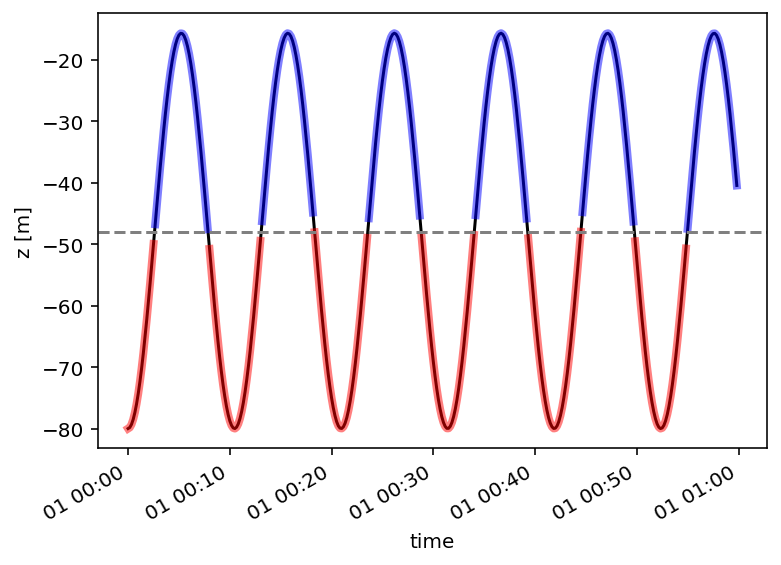

In [38]:
plot_buoyant_object(filename)

### 3.10.8 Discussion of Results


Initially, the object is
lighter compared with the ambient fluid and experiences a positive (upward) buoyancy force. Hence, the object becomes subject to upward acceleration and its vertical
speed increases until the object reaches its equilibrium level at a depth of 50 m. This
takes about 2.5 h.
It overshoots this level, for it takes some time before deceleration has reduced the
object’s speed again to zero. When this occurs, however, the object finds itself at a
depth horizon of around 20 m in a less dense environment. It experiences a negative
buoyancy force and, accordingly, is subject to downward acceleration. Again, it
moves past its equilibrium density level. This overshooting is a form of inertia and
the resultant movement of the object is a vertical oscillation about its equilibrium
density level. The period of this oscillation is slightly above 10 min.

### 3.10.9 Analytical Solution

Combining the momentum and location equations gives differential equation

$$ \frac{d^2 z^∗}{dt^2} = −N^2 z^∗ $$

where $z^*$ is the distance from the object to its  equilibrium
density level.

The solution is given by

$$ z^*(t) = z_0^* \cos (N t) $$

where $z_0^*$ is s the initial distance from the equilibrium level.

Vertical speed evolves according to 

$$ w = \frac{dz^*}{dt} =  z_0^* N \sin (N t) = w_0 \sin (N t) $$

where $w_0 = z_0^* N$ is the maximum speed that the object attains as it crosses its density equilibrium level. In our example, $z_0^* = 30$ m and $N = 0.01$ s$^{−1}$ give a maximum
vertical speed of around 30 cm/s.

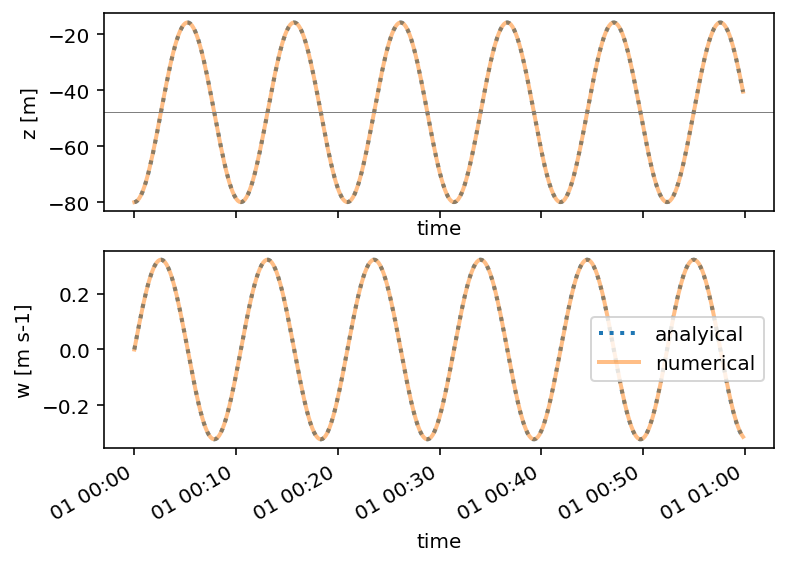

In [41]:
def plot_with_analytic_solution(filename):
    
    fig, (ax1, ax2) = plt.subplots(nrows=2, sharex=True)
    
    ds = xr.open_dataset(filename)
    
    # convert "timedelta64[ns]" to seconds
    t = (ds.time - ds.time[0])/ np.timedelta64(1, 's')
    
    N = 0.01
    
    z_eqm = -50
    
    # more precisely,
    # z_eqm = ( 1 - rho / rhos) * g/N2
    z_eqm = (1 - 1025.5 / 1025 ) * 9.81 / 0.0001 
    
    z0 = z_eqm - (-80) # z_0^*
    
    z = z_eqm - z0 * np.cos(N*t)
    
    z.plot(ax=ax1,  ls=':', lw=2)
    ds.z.plot(ax=ax1, ls='-', lw=2, alpha=0.5)
    
    w0 = z0 * N
    w = w0 * np.sin(N*t)
    
    w.plot(ax=ax2, label='analyical', ls=':', lw=2)
    ds.w.plot(ax=ax2, label='numerical', ls='-', lw=2, alpha=0.5)
    
    ax1.axhline(z_eqm, color='gray', linestyle='-', lw=0.5,) 
    
    plt.legend(loc='right')

    
plot_with_analytic_solution(filename)

---

## Problem 3

1. Following OMB 3.10.10, modify the program `buoyant_object()` to
include a linear friction term in the model of oscillating buoyant object.  In your solution should include a figure similar to Fig 3.10 showing the oscillation of the object over time with a friction parameter of R = 0.002 s$^{-1}$.

2. Repeat this exercise with the inclusion of friction and vary the friction coefficient in
a range between 0.001 s$^{−1}$ and 0.5 s$^{−1}$.  Create visualizations showing the effect of changing the parameter $R$.

3. Implement
a quadratic friction term of the form $−R | w | w$, where $r$ has now units of 1/m.
Use a semi-implicit approach for this term; that is $−R | w^{n} | w^{n+1}$, and choose different values of $R$. Create a visualization comparing linear friction to a quadratic friction.

Include a written component to your solution (including the mathematics) and not just submit code and plots.

---



## OMB 3.11 The Pressure-Gradient Force

Read and review.

Key terms:
- Hydrostatic vs nonhydrostatic
- Dynamic pressure
- Boussinesq approximation
- Barotropic flow
- Baroclinic flow

## OMB 3.12 The Coriolis Force

Read and review.

- Centrifugal force
- Coriolis force
- inertial oscillations

### OMB 3.13 The Coriolis Force on Earth

Read and review.

- Coriolis parameter
- f-plane approximation
- beta-plane approximation





## OMB 3.15 Exercise 4: The Coriolis Force in Action

Consider the motion of a parcel subject only to Coriolis forces:

$$\begin{align}
\frac{\partial u}{\partial t} &= + fv \\
\frac{\partial v}{\partial t} &= - fu \\
\end{align}$$

where $f = 2 \Omega \sin(\phi)$, with $\Omega$ the rotation rate of the Earth and $\phi$ being geographical latitude, is called the *Coriolis parameter*.



### 3.14.1 Aim

The aim of this exercise is to predict the pathway of a non-buoyant fluid parcel in a rotating fluid subject to the Coriolis force.

We consider a fluid tank, 20 km in diameter, rotating at a rate of $\Omega =−7.272 \times 10^{−5}$ s$^{−1}$, which corresponds to clockwise rotation with a period of 24 h. At location $x=0$ and $y=5$ km, a disturbance is introduced such that the fluid parcel obtains a relative speed of $u_0= 0.5$ m/s and $v_0= 0.5$ m/s. 

As always, we'll need a way to save the results of our simulation:

In [73]:
def init_output(basename, **attrs):
    
    # ensure we are writing to a new file each time
    previous_files = sorted(glob.glob(f'OUTPUT/{basename}_*.nc'))
    if len(previous_files) == 0:
        counter = 1    
    else:
        counter = int(previous_files[-1][-7:-3]) + 1
    filename = f'OUTPUT/{basename}_{counter:04d}.nc'
        
    nc = netCDF4.Dataset(filename, "w")

    # NetCDF files have 'dimensions'
    nc.createDimension("time")

    # NetCDF files have 'variables'
    nc.createVariable("time", "f8", ("time",))
    # NetCDF variables can have 'attributes'
    nc.variables["time"].units = "seconds since 2000-01-01"
    nc.variables["time"].calendar = "gregorian"
    
    nc.createVariable("u", "f8", ("time",))
    nc.variables["u"].units = "m s-1"
    nc.createVariable("v", "f8", ("time",))
    nc.variables["v"].units = "m s-1"
    nc.createVariable("x", "f8", ("time",))
    nc.variables["x"].units = "m"
    nc.createVariable("y", "f8", ("time",))
    nc.variables["y"].units = "m"

    # NetCDF files have also have global attributes
    nc.setncatts(attrs)
    nc.history = "Created " + time.ctime(time.time())
    nc.source = "OMB Exercise 4"
    nc.filename = filename

    # It is important to close a NetCDF file
    nc.close()
    
    return filename

def write_output(filename,
                 t, u, v, x, y,
                 n=None):
    # open a NetCDF file in 'append' mode
    nc = netCDF4.Dataset(filename, mode='a')
    
    # if n is not provided, place values in the last position
    if n is None:
        n = len(nc.variables['time'])
        
    nc.variables["time"][n] = t
    nc.variables["u"][n] = u
    nc.variables["v"][n] = v
    nc.variables["x"][n] = x
    nc.variables["y"][n] = y
    
    # It is important to close a NetCDF file
    nc.close()

And a overall program that in going to control the simulation:

In [1]:
def coriolis_force_example(
    dt = 600, # value of time step in seconds
    tmax = 3*24, # total simulation is 3 days
    toutput = 1, # output at every 3 hours of the simulation
):

    Ω = -7.272e-5 # rotation rate of the earth
    ϕ = np.deg2rad(90) # latitude of 90 degrees N
    f = 2*Ω*np.sin(ϕ) # Coriolis parameter
    
    # every hour is 60 minutes of 60 seconds each
    ntot = int(tmax * 3600 / dt)
    nout = int(toutput * 3600 / dt)
    
    filename = init_output(f'coriolis_force',
                description= f"Corolis Force in Action",
                dt=dt,
                f=f)
         
    # initial conditions
    u = 0.5 # m/s
    v = 0.5 # m/s
    x = 0
    y = 5000
    t = 0
    
    # save initial values
    write_output(filename, t, u, v, x, y)

    for n in range(1, ntot):

        # time counter
        t = n * dt

        # update u, v, x, and y for each time step
        u, v, x, y = update_step(t, dt, f, u, v, x, y)
            
        # Data output if the counter is constant integer multiple of nout
        # For instance, nout = 30 produces outputs at i = 30, 60, 90, ...
        if n % nout == 0:
            write_output(filename, t, u, v, x, y)
            
    return filename

Notice that this program is dependent on a subroutine called `update_step()` which we still need to write.

We also can write a subroutine for the visualization of the results:

In [2]:
import matplotlib.dates as mdates

def plot_coriolis_force_example(filename):
    ds = xr.open_dataset(filename)

    fig, (ax1, ax2) = plt.subplots(ncols=2)

    # plot position in x-y
    ax1.plot(ds.x / 1000, ds.y / 1000, '.-')
    
    ax1.axis('equal')
    ax1.set_xlabel('x (km)')
    ax1.set_ylabel('y (km)')
    
    # plot u,v as a function of time
    ax2.plot(ds.time, ds.u)
    ax2.plot(ds.time, ds.v)
    
    days = mdates.DayLocator()   # every day
    hours = mdates.HourLocator(byhour=range(0, 24, 3))  # every three hours
    fmt = mdates.DateFormatter('%m-%d')
    
    # format the ticks
    ax2.xaxis.set_major_locator(days)
    ax2.xaxis.set_minor_locator(hours)
    ax2.xaxis.set_major_formatter(fmt)
    ax2.set_ylabel('u, v (m/s)')
      
    ax2.yaxis.set_label_position("right")
    ax2.yaxis.tick_right()

    
    fig.autofmt_xdate()


### 3.14.2 First Attempt

We can discretizing our equations for a rotation fluid as

$$\begin{align}
u^{n+1} &= u^n + \Delta t f v^n  \\
v^{n+1} &= v^n - \Delta t f u^n  \\
\end{align}
$$

with the locations of the fluid parcels predicted with:

$$\begin{align}
x^{n+1} &= x^n + \Delta t u^n  \\
y^{n+1} &= y^n + \Delta t v^n  \\
\end{align}
$$


In code, this would implemented as:

In [77]:
def update_step(t, dt, f, u, v, x, y):
    
    un = u + dt * f * v
    vn = v - dt * f * u
    xn = x + dt * u
    yn = y + dt * v
    
    return un, vn, xn, yn  

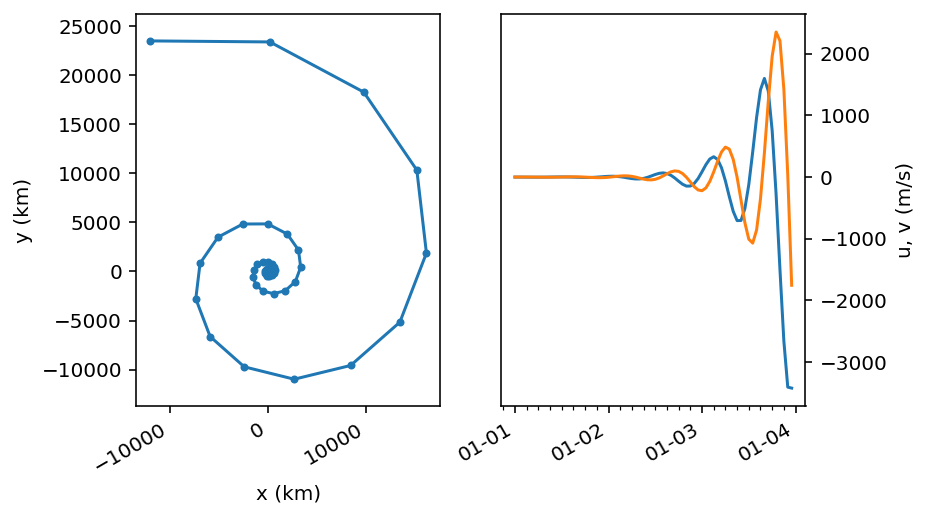

In [80]:
filename = coriolis_force_example(dt=3600, toutput=1, tmax=3*24)
plot_coriolis_force_example(filename)

Unfortunately, this method is numerically unstable for all values of $\Delta t$.

### 3.14.3 Improved Scheme 1: the Semi-Implicit Approach

For circular motion, a semi-implicit scheme works better:

$$\begin{align}
u^{n+1} &= u^n + 0.5 \alpha (v^n + v^{n+1}) \\
v^{n+1} &= v^n - 0.5 \alpha (u^n + v^{u+1}) \\
\end{align}
$$

where $\alpha= \Delta t f$.  Cross-combination of these equations gives

$$\begin{align}
u^{n+1} &= [(1-\beta) u^n + \alpha v^n]/ (1+\beta) \\
v^{n+1} &= [(1-\beta) u^n - \alpha v^n]/ (1+\beta) \\
\end{align}
$$

where $\beta =0.25 \alpha^2$.

This scheme requires numerical time steps to be small compared to the rotation period: $|\alpha| \ll 1$.

(Note: a fully-implicit scheme would lead to an inward spiralling of trajectories and a gradual decrease in speed.)


In [81]:
def update_step(t, dt, f, u, v, x, y):
    
    α = dt*f
    β = 0.25 * α**2
    un = ((1-β)*u + α*v)/(1+β)
    vn = ((1-β)*v - α*u)/(1+β)

    xn = x + dt * u
    yn = y + dt * v
    
    return un, vn, xn, yn 

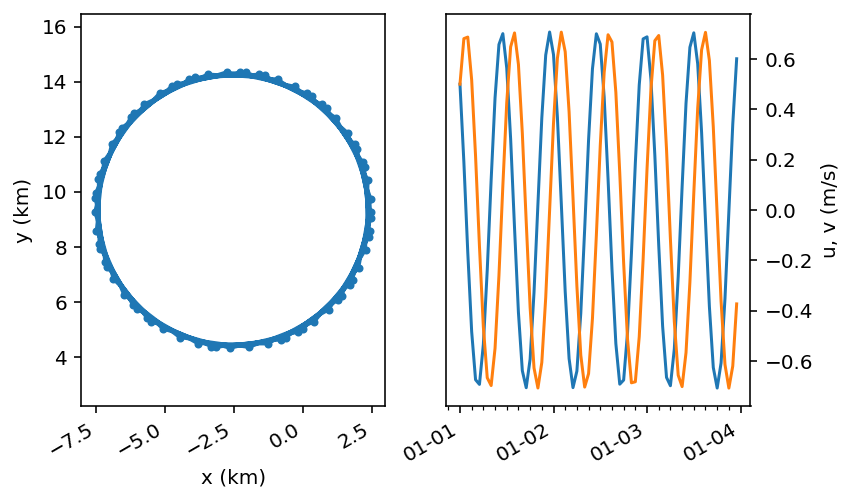

In [82]:
filename = coriolis_force_example(dt=3600, toutput=1, tmax=3*24)
plot_coriolis_force_example(filename)

### 3.14.4  Improved Scheme 2: The Local-Rotation Approach

We can take advantage of the Coriolis force always operating at right angles to the velocity which means it changes only the direction and not the speed of the parcel.  This can be modelled by a local rotation of the velocity vector:

$$\begin{align}
u^{n+1} &= \cos(\alpha) u^n + \sin(\alpha) v^n\\
v^{n+1} &= \cos(\alpha) v^n - \sin(\alpha) u^n\\
\end{align}
$$

From the geometry of the problem we can show that this rotation angle is $\alpha = 2 \arcsin(0.5 \Delta t f)$. For $\Delta t |f | \ll 1$, then we can use the approximation $\alpha \approx \Delta t f$.

In [83]:
def update_step(t, dt, f, u, v, x, y):
    
    α = dt*f
    
    un = np.cos(α)*u + np.sin(α)*v
    vn = np.cos(α)*v - np.sin(α)*u

    xn = x + dt * u
    yn = y + dt * v
    
    return un, vn, xn, yn 

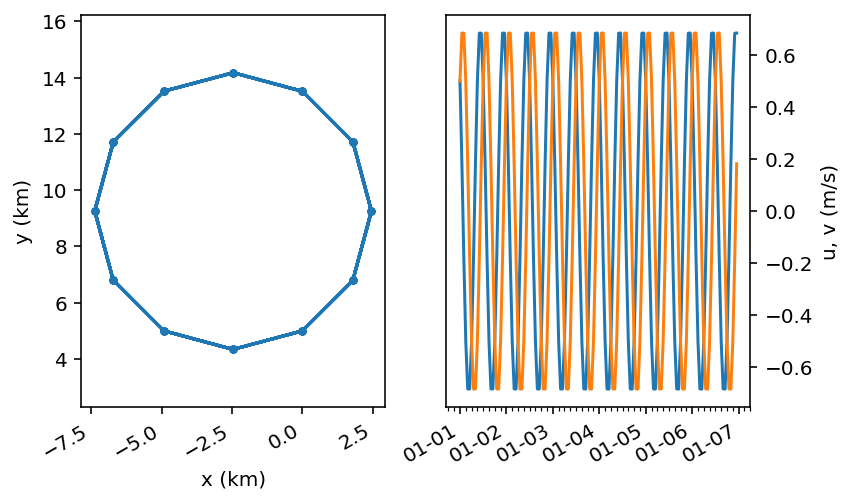

In [84]:
filename = coriolis_force_example(dt=3600, toutput=1, tmax=6*24)
plot_coriolis_force_example(filename)

---
## Problem 4

Read OMB 3.14.7 and simulate an inertial oscillation and numerically recreate Fig 3.25. Your solution should include the equations to be solved written out in $\LaTeX$ notation and some written comments on the physical problem being solved. You may refer to the textbook solution `InerOsci.95` if you need some guidance on implementing the "abrupt forcing" changes.

Compare both the semi-implict (3.14.3) and the location-rotation (3.14.4) appoaches.

---


## OMB 3.15 Turbulence

Read and review.

## OMB 3.16 The Navier-Stokes Equations

Discuss equations and boundary conditions

## OMB 3.17 Scaling

Read and review.